In [71]:
import numpy as np
import pandas as pd
import xarray as xr
import uxarray as ux

import dask as da
import dask.dataframe as dd
import multiprocessing as mp

import spatialpandas as sp
import spatialpandas.dask 

import holoviews as hv
from holoviews import opts
from holoviews.operation.datashader import rasterize
import geoviews as gv
import geoviews.feature as gf

import datashader as ds
import datashader.transfer_functions as tf

import hvplot.pandas
import hvplot.xarray  
import hvplot.dask

from matplotlib import cm
import cartopy.crs as ccrs

In [2]:
import sys
%load_ext autoreload
%autoreload 2
sys.path.insert(1, '/glade/u/home/philipc/geocat-scratch/polymesh/polymesh')

from polymesh import polymesh as polymesh

# NOAA-Geoflow Data

In [3]:
# GeoFlow Small (6,000 faces)
ds_base_path = "/glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/small/"

ds_grid_small = ux.open_dataset(ds_base_path + "grid.nc",
                                ds_base_path + "v1.000000.nc",
                                ds_base_path + "v2.000000.nc",
                                ds_base_path + "v3.000000.nc")

# GeoFlow Large (6,000,0000 faces)
ds_base_path = "/glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/large/"

ds_grid_large = ux.open_dataset(ds_base_path + "grid.nc",
                                ds_base_path + "v1.000000.nc",
                                ds_base_path + "v2.000000.nc",
                                ds_base_path + "v3.000000.nc")

Loading initial grid from file:  /glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/small/grid.nc
Loading initial grid from file:  /glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/large/grid.nc


# Mesh Construction

In [4]:
%%time
projection = ccrs.Robinson()
geoflow_small = polymesh(ds=ds_grid_small, projection=projection)

CPU times: user 25.4 ms, sys: 1.94 ms, total: 27.4 ms
Wall time: 28.7 ms


In [25]:
%%time
projection = ccrs.Robinson()
geoflow_large = polymesh(ds=ds_grid_large, projection=projection)

CPU times: user 10.2 s, sys: 2.08 s, total: 12.3 s
Wall time: 12.5 s


#  Visualization

In [57]:
hv.output(fig='svg', size=400)
cmap = cm.coolwarm

## Single Plot (Static)

:DynamicMap   []
   :Overlay
      .Image.I     :Image   [x,y]   (x_y faces)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]
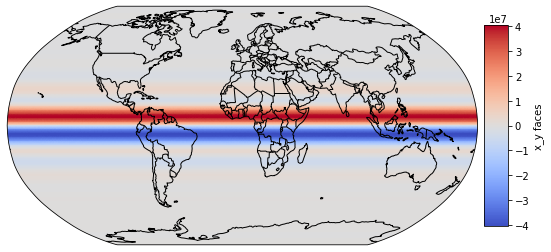

In [59]:
# Specify Data Variable and Dimensions for Plotting
df = geoflow_large.data_mesh(name="v3", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")

# Use hvPlot and geoviews  to create a rasterized plot with geographic features
v3_t0_mL0_l = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

v3_t0_mL0_l

## Single Plot (Interactive)

In [65]:
hvplot.extension('bokeh')

# Specify Data Variable and Dimensions for Plotting
df = geoflow_large.data_mesh(name="v3", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")

# Use hvPlot and geoviews  to create a rasterized plot with geographic features
v3_t0_mL0_l = df.hvplot.polygons(rasterize=True, project=False, aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

v3_t0_mL0_l

:DynamicMap   []
   :Overlay
      .Image.I     :Image   [x,y]   (x_y faces)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]

## Multiple Plots (Small Dataset)

CPU times: user 179 ms, sys: 6.01 ms, total: 185 ms
Wall time: 261 ms


:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .Image.I     :Image   [x,y]   (x_y faces)
         .Coastline.I :Feature   [Longitude,Latitude]
         .Borders.I   :Feature   [Longitude,Latitude]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .Image.I     :Image   [x,y]   (x_y faces)
         .Coastline.I :Feature   [Longitude,Latitude]
         .Borders.I   :Feature   [Longitude,Latitude]
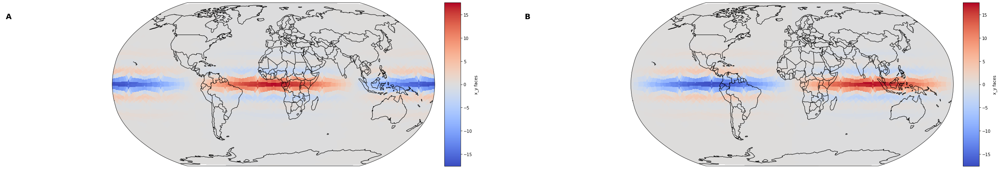

In [66]:
%%time
hvplot.extension('matplotlib')

df = geoflow_small.data_mesh(name="v1", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")
v1_t0_mL0_s = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

df = geoflow_small.data_mesh(name="v2", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")
v2_t0_mL0_s = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

v1_t0_mL0_s + v2_t0_mL0_s

## Multiple Plots (Large Dataset)

CPU times: user 921 ms, sys: 45.9 ms, total: 967 ms
Wall time: 1.09 s


:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .Image.I     :Image   [x,y]   (x_y faces)
         .Coastline.I :Feature   [Longitude,Latitude]
         .Borders.I   :Feature   [Longitude,Latitude]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .Image.I     :Image   [x,y]   (x_y faces)
         .Coastline.I :Feature   [Longitude,Latitude]
         .Borders.I   :Feature   [Longitude,Latitude]
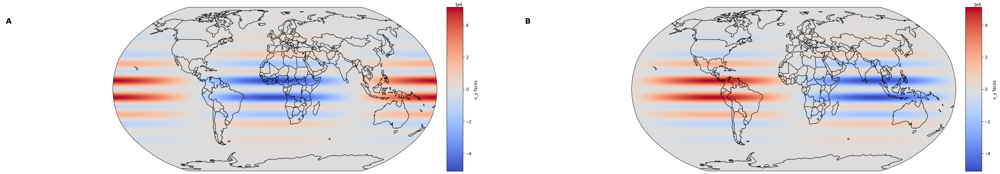

In [67]:
%%time
hvplot.extension('matplotlib')

df = geoflow_large.data_mesh(name="v1", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")
v1_t0_mL0_l = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

df = geoflow_large.data_mesh(name="v2", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")
v2_t0_mL0_l = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

v1_t0_mL0_l + v2_t0_mL0_l

## Grid Visualization

""

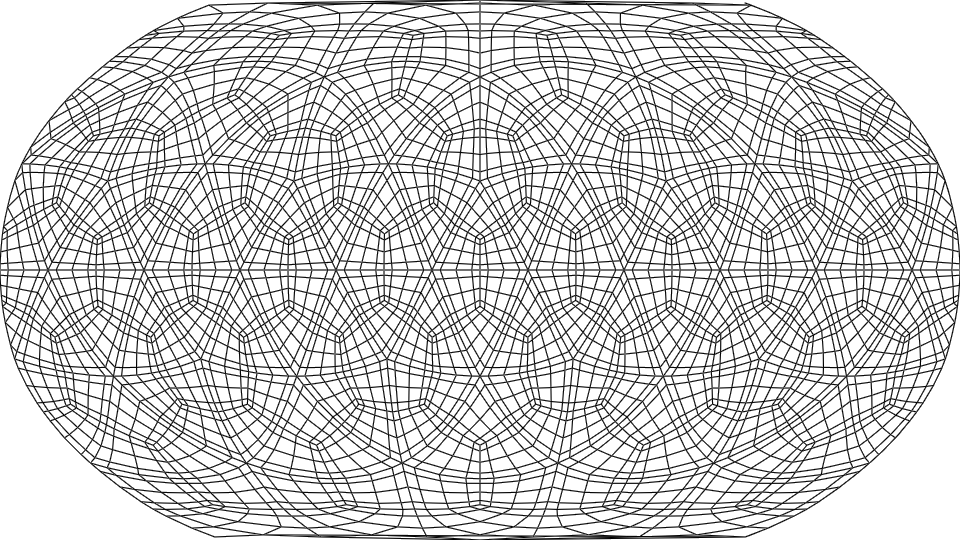

In [79]:
# Select any data variable
df = geoflow_small.data_mesh(name="v1", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")

cvs = ds.Canvas(plot_width=960, plot_height=540)
agg = cvs.line(df, geometry='geometry', agg=ds.any(), line_width=0.5)
outline = tf.shade(agg, cmap='black')
grid = tf.Images(outline)
grid